<a href="https://colab.research.google.com/github/Frostofree/CVIT_Worskshop/blob/main/CVIT_Orientation_Day_2_Task_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Skew Correction

This google colab notebook introduces basic Document Image Processing Method called **Skew Correction**. 

Skew refers to the rotation of a document image from its intended orientation. This can happen during the scanning process and can affect the readability and usability of the document image.

---

Use the following drive link to access the images.

Drive Link: https://drive.google.com/drive/folders/1ivc4ISlTaUerNKcrMZUIb1yU-wkDZW-Y


## Mounting the google drive and loading requried libraries

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/


In [4]:
import numpy as np
from skimage.transform import hough_line, hough_line_peaks, probabilistic_hough_line
from skimage.transform import rotate
from skimage.feature import canny
from skimage.io import imread
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
from scipy.stats import mode
import cv2
from google.colab.patches import cv2_imshow

## 1. Skew Detection: 3 Steps

[[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]


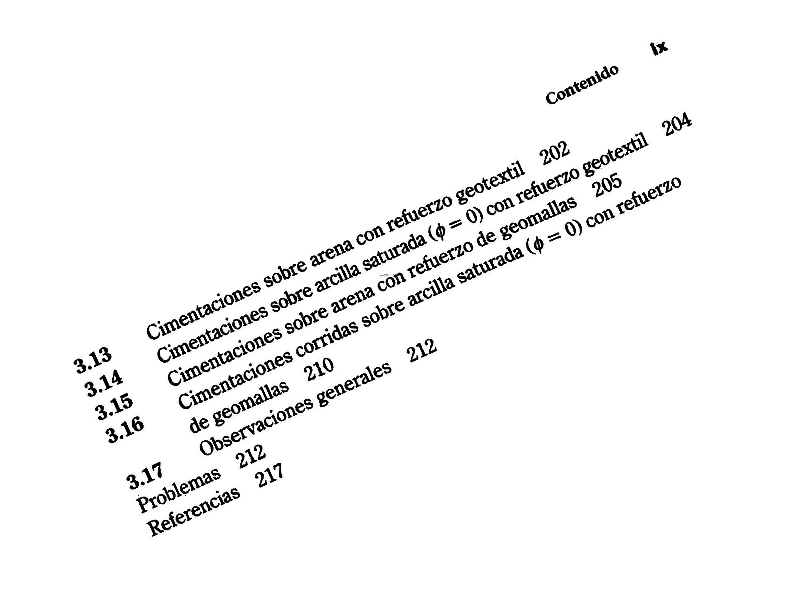

In [ ]:
#@title Read Images
# reading Images 
path = '/content/drive/MyDrive/skew/easy/1.png'
image = imread(path)
cv2_imshow(image)

Convert to Grayscale

2


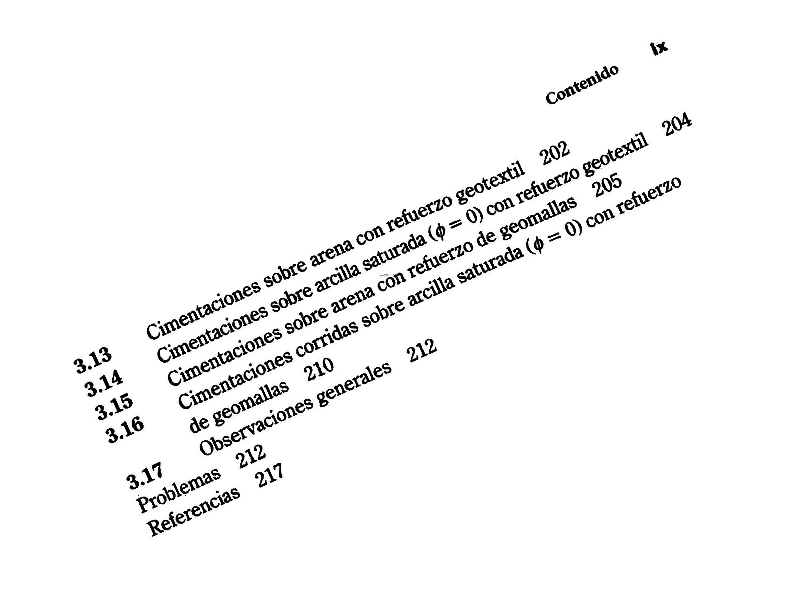

In [ ]:
# print(len(image.shape)) # Already in grayscale, only 2 channels
# gray = rgb2gray(image[:,:,:3])
if len(image.shape) > 2 :
  gray = rgb2gray(image[:,:,:3])
else:
  gray = image
    
cv2_imshow(gray)

# Alpha Channel is the 4th channel which is to be dropped. it ranges from 0.0(fully transparent) to 1.0 (fully opaque)



Why the **3** in `image[:,:,:3]`?

In [ ]:
#@title Solution
if len(image.shape)>2:
  gray = rgb2gray(image[:,:,:3])
else:
  gray = image

cv2_imshow(gray)

#### Step-1: Edge Detection - `Canny` 

- Recall Yesterday's Sobel Filters!
- Canny Edge Detection is Similar with Extra Preprocessing and Refinement Steps like: Noise Reduction, Non-Maximal Supression, etc. 

Reference: 
1. https://docs.opencv.org/3.4/da/d22/tutorial_py_canny.html
2. https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.canny


Function Signature: `canny(image, sigma=1.0, low_threshold=None, high_threshold=None, mask=None, use_quantiles=False, *, mode='constant', cval=0.0)`

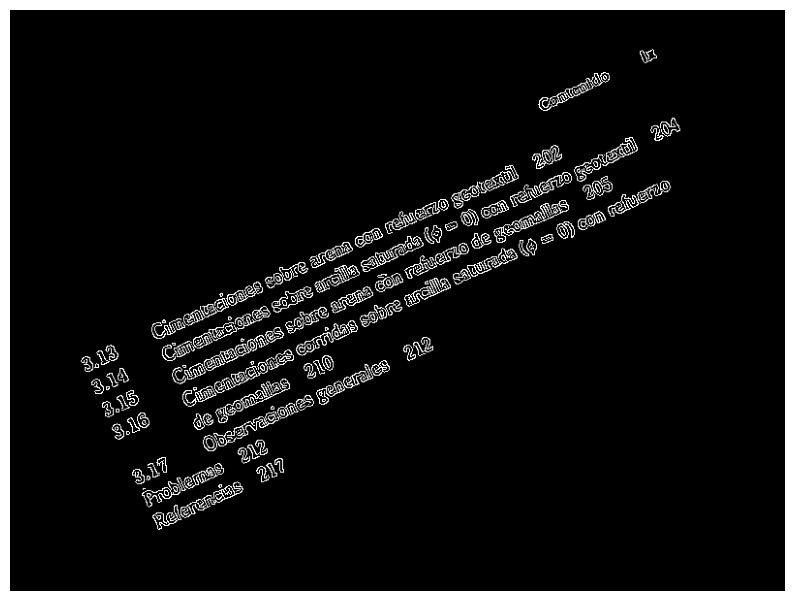

In [ ]:
# edge detection
edges = canny(gray,sigma=1.0)

# As the sigma value increases,the gaussian filter becomes more spread out, hence increasing the smoothing effect. so more neighbouring pixels contribute to the calculation of each pixel's intensity value
# When sigma is small, the Gaussian filter is more localized, leading to less smoothing and preserving finer details in the image. However, this can also make the edge detection more sensitive to noise, causing the algorithm to detect more false edges.

# very large sigma values may lead to blurring of the edges, causing them to appear less defined or even get completely eliminated.

plt.figure(figsize=(10,8))
plt.axis('off')
plt.imshow(edges, cmap='gray')

### Step-2: Line Detection - `Hough Transform`

Reference: https://scikit-image.org/docs/stable/auto_examples/edges/plot_line_hough_transform.html

Define Range of Angles

In [ ]:
# define range of angles
angles = np.deg2rad(np.arange(0.1, 180.0))
# print(angles)
print('Count: ',len(angles))

Count:  180


Use `hough_line(edges, theta=angles)` from skimage

Returns:
- `hspace`: is a 2D array that represents the Hough accumulator. The Hough accumulator is a data structure that is used to store the number of times each possible line is detected in the image.
- `theta`: is a 1D array that represents the angles of the detected lines. The angles are measured in radians.
- `distance`: is a 1D array that represents the distances of the detected lines from the origin. The distances are measured in pixels.

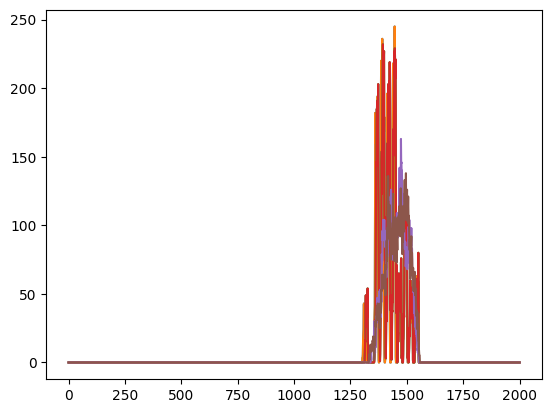

In [ ]:
h, theta, d = hough_line(edges, theta=angles)       # r,theta is a line

# resolution for r is how far away two lines should be to consider them two different lines

# Upon plotting the lines on a r,theta histogram we can see peaks. These peaks are the most probable (r,theta) lines that are to be detetcted

plt.plot(h)

**Get Prominent Lines**: `hough_line_peaks`

Function Signature: `hough_line_peaks(hspace, angles, dists, min_distance=9, min_angle=10, threshold=None, num_peaks=inf)`

- Most prominent lines separated by a certain angle and distance in a Hough transform.
- Performs [Non-maximum Suppression](https://towardsdatascience.com/non-maximum-suppression-nms-93ce178e177c) to identify Peaks

In [ ]:
# find line peaks and angles
# min distance is the minimum r value required to filter out 2 different lines.
# similarly with min angle
accum, angles, dists = hough_line_peaks(h, theta, d)
# h.max() is 245

In [ ]:
list(zip(*hough_line_peaks(h, theta, d)))

[(245, 1.1536626355682518, 446.0),
 (236, 1.1536626355682518, 391.0),
 (219, 1.1362093430483085, 424.0),
 (203, 1.1362093430483085, 373.0),
 (163, 0.9791297103688189, 474.0),
 (138, 0.9267698328089891, 496.0)]

##### Visualize Detected Lines

Text(0.5, 1.0, 'Detected lines')

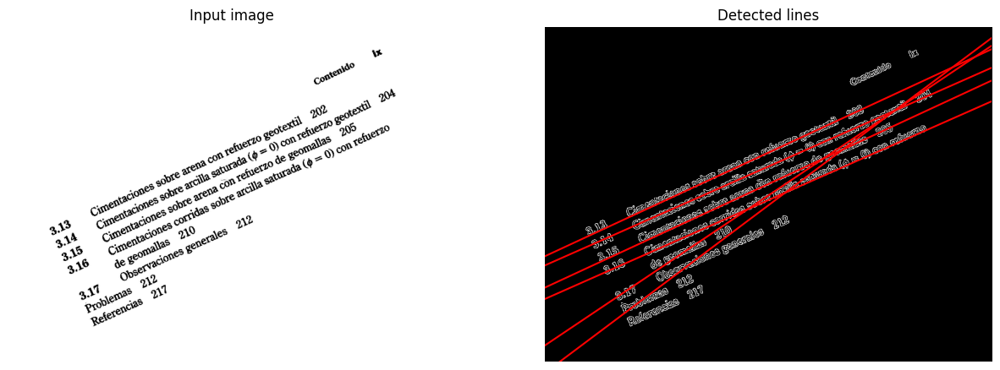

In [ ]:
# Generating Plots
fig, axes = plt.subplots(1, 2, figsize=(15, 15))    # nrows = 1 ncols = 2
ax = axes.ravel()

ax[0].imshow(gray, cmap="gray")
ax[0].set_title('Input image')
ax[0].set_axis_off()

ax[1].imshow(edges, cmap="gray")
origin = np.array((0, image.shape[1]))

# plot lines
for _, angle, dist in zip(*hough_line_peaks(h, theta, d)):
    y0, y1 = (dist - origin * np.cos(angle)) / np.sin(angle)
    ax[1].plot(origin, (y0, y1), '-r')
    
ax[1].set_xlim(origin)
ax[1].set_ylim((edges.shape[0], 0))
ax[1].set_axis_off()
ax[1].set_title('Detected lines')

In [ ]:
# Try Faster Houghline!
lines = probabilistic_hough_line(edges, threshold=10, line_length=5,
                                 line_gap=3)


### Step-3: Domninant Angle - Most Common Angle

##### Visualize Hough Space

(67.39999999999999, 51.800000000000004, 1000.5, -1000.5)

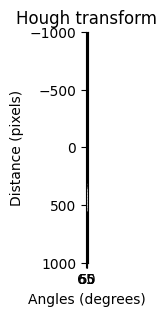

In [ ]:
# Visualize Hough Space

angle_step = 0.5 * np.diff(theta).mean()
d_step = 0.5 * np.diff(d).mean()
bounds = [np.rad2deg(theta[0] - angle_step),
          np.rad2deg(theta[-1] + angle_step),
          d[-1] + d_step, d[0] - d_step]


plt.imshow(np.log(1 + h), extent=bounds, cmap='gray', aspect=1 / 1.5)
plt.title('Hough transform')
plt.xlabel('Angles (degrees)')
plt.ylabel('Distance (pixels)')
plt.axis('image')

##### Mode - Common

In [ ]:
# round the angles to 2 decimal places and find the most common angle.
dominant_angle = mode(np.around(angles, decimals=3), keepdims=False)[0]
dominant_angle

1.136

In [ ]:
# convert the angle to degree for rotation.
skew_angle = np.rad2deg(dominant_angle - np.pi/2)
# skew_angle = np.rad2deg(dominant_angle)
skew_angle

-24.91199447313849

Why did we subtract $\frac{Π}{2}$?

Try without Subtracting!

In [ ]:
angle_ = np.rad2deg(dominant_angle)
angle

0.9267698328089891

## 2. Skew Correction: Rotate the image to deskew it

### Finaly There!! Get the rotated Image Back! Easy

![](https://media.tenor.com/PriVq8YusysAAAAM/yeah-but-how-stan-marsh.gif)


### Apply Affine Transform!

<img src="https://res.cloudinary.com/practicaldev/image/fetch/s--_L7TDW3Y--/c_imagga_scale,f_auto,fl_progressive,h_900,q_auto,w_1600/https://dev-to-uploads.s3.amazonaws.com/i/yhc6kp16j6bi5ddtfn88.png" alt= “Affine” width="60%" height="value">

What is an Affine Transformation?
- A transformation: a matrix multiplication (linear transformation) followed by a vector addition (translation).
- Parallel Line remain parallel after Transform

We can express following with Affone:
- Rotations (linear transformation)
- Translations (vector addition)
- Scale operations (linear transformation)

Resource: https://docs.opencv.org/3.4/d4/d61/tutorial_warp_affine.html

How do we rotate?
$$
R = \begin{bmatrix}
α & β & (1−α)⋅center.x−β⋅center.y \\
-β & α & β⋅center.x+(1−α)⋅center.y
\end{bmatrix}
$$
![](https://i.imgflip.com/11dmtp.jpg)
![opencv](./7mr495.jpg)

Function: `cv2.getRotationMatrix2D(center, angle, scale)`

Paramters:
- `center`:	Center of the rotation in the source image.
- `angle`:	Rotation angle in degrees. Positive values mean counter-clockwise rotation (the coordinate origin is assumed to be the top-left corner).
- `scale`:	Isotropic scale factor.

Find Centre

In [ ]:
# find center
(h, w) = image.shape[:2]
center = (w // 2, h // 2)

Get Rotation Matrix, $R$

Reference: https://docs.opencv.org/3.4/da/d54/group__imgproc__transform.html#gafbbc470ce83812914a70abfb604f4326

In [ ]:
R = cv2.getRotationMatrix2D(center, skew_angle, 1.0)
R

array([[   0.90695585,   -0.42122569,  163.58536485],
       [   0.42122569,    0.90695585, -140.57703105]])

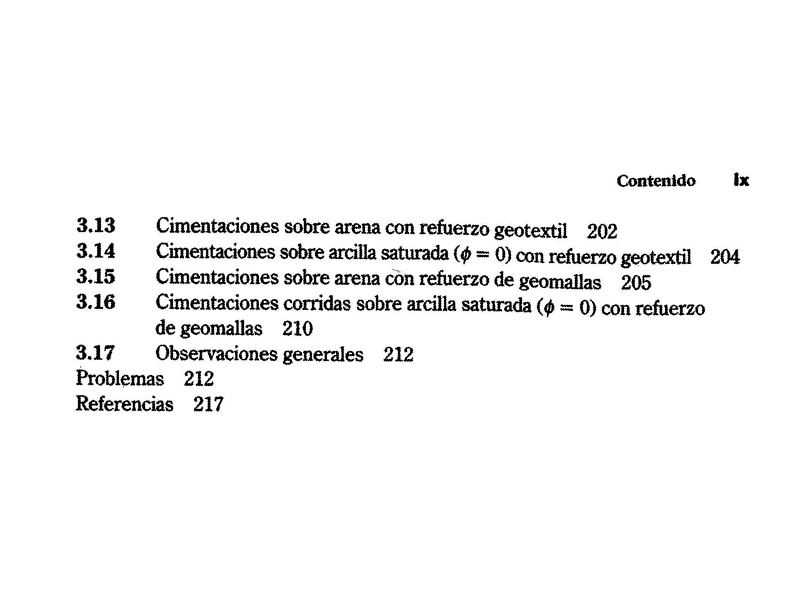

In [ ]:
rotated = cv2.warpAffine(image, R, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)      # Default is linear interpolation
# The cv2.INTER_CUBIC flag is used in OpenCV, a popular computer vision library, to specify the interpolation method known as "bicubic interpolation." 
# Interpolation is the process of estimating pixel values at non-integer coordinates when resizing or rescaling images.
# 
cv2_imshow(rotated)

Another Way!

Rotate Fn Signature: `rotate(image, angle, resize=False, center=None, order=None, mode='constant', cval=0, clip=True, preserve_range=False)`

Reference: https://scikit-image.org/docs/stable/api/skimage.transform.html#skimage.transform.rotate

In [ ]:
rotated_faulty = rotate(image, skew_angle, resize=False, center=None, order=None, mode='constant', cval=0, clip=True, preserve_range=False)

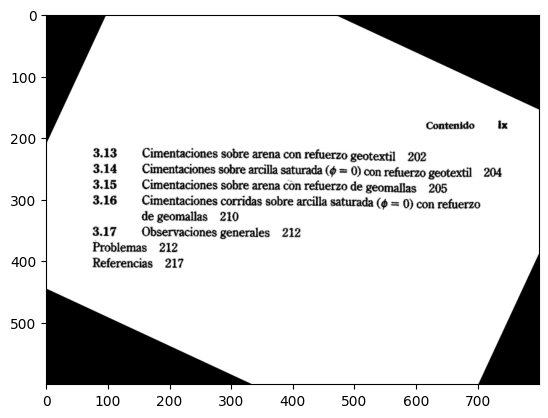

In [ ]:
plt.imshow(rotated_faulty, cmap='gray')

Issues:
1. Colour: Black Region
2. Boundaries

Fix it!

#### Skew Correction: Final Function 

In [65]:
# skew detecttion
def detect_skew(img:np.ndarray, show_interm=False)->float:
  # convert to edges, we need denoied image for this step only

  edges = canny(img)

  # compute hough space
  angles = np.deg2rad(np.arange(0.1,180.0))
  h, theta , d = hough_line(edges, theta=angles)

  # find peaks in hough space
  accum, angles, dists = hough_line_peaks(h, theta, d)
  lines = zip(accum,angles,dists)

  if show_interm:
    show_detected_lines(img,edges,lines)

  # find dominant angle
  dominant_angle = mode(np.around(angles,decimals=3), keepdims=False)[0]    # np.around evenly rounds decimals

  # convert angle to degrees for rotation

  skew_angle = np.rad2deg(dominant_angle - np.pi/2)
  

  return skew_angle

def preprocessing(image:np.ndarray, noprep=False):
  if len(image.shape)>2:
    image = rgb2gray(image[:,:,:3])               # conver to grayscale

  if noprep == False:
    blur = cv2.GaussianBlur(image, (5, 5), 0)               
    # Apply image denoising
    denoised = cv2.fastNlMeansDenoising(blur, None, h=10, templateWindowSize=7, searchWindowSize=21)      # gaussian denoising
      
    # Apply binary thresholding
    _, binary = cv2.threshold(denoised, 127, 255, cv2.THRESH_BINARY)

    return binary
  else:
    return image  

# rotate Image
def deSkew(image:np.ndarray,skew_angle:float)->np.ndarray:
  # Rotate image to deskew it
  (h,w) = image.shape[:2]
  center = (w // 2, h // 2)       # origin

  R = cv2.getRotationMatrix2D(center, skew_angle, 1.0)
  rotated = cv2.warpAffine(image, R, (w,h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)

  # plt.imshow(rotated)
  
  return rotated

def post_processing(rotated: np.ndarray)->np.ndarray:
  # Hint: The images don't look crisp! And the borders seem visible
  (h,w) = rotated.shape[:2]

  tx,ty = -w/8,0                   # using 1/8ths

  # create translation matrix
  translation_matrix = np.array([
      [1,0,tx],
      [0,1,ty]
  ],dtype=np.float32)

  translated_image = cv2.warpAffine(src=rotated, M=translation_matrix, dsize=(w, h))
  
  return translated_image

def resize_image(rotated: np.ndarray)->np.ndarray:

  (h,w) = rotated.shape[:2]

  resized = cv2.resize(image, (780, 540),
               interpolation = cv2.INTER_AREA)

def SkewCorrection(path, verbose=False, noprep=True, nopostprep=True):
  # read Image
  img = imread(path)

  img_pre = preprocessing(img,noprep=True)            # check if preprocessing is required or not

  if noprep == False:
    plt.title("After Preprocessing")
    plt.imshow(img_pre, verbose)

  # if len(img.shape)>2:          # moved to seperate function for modularity
  #   image = rgb2gray(img[:,:,:3])               # conver to grayscale
  # else:
  #   image = img

  
  # determine angle
  skew_angle = detect_skew(img_pre, verbose)

  if verbose:
    print(f'Skew Angle is {skew_angle:.3f}')

  # Rotate Image
  rotated = deSkew(img, skew_angle)

  # post processing!
  if nopostprep == False:
    rotated_final = post_processing(rotated)
  else:
    rotated_final = rotated

  # rotated_final = post_processing(rotated)
  
  # plot images
  plot_images(img, rotated_final)

  return rotated_final

In [56]:
def plot_images(image, rotated):
  fig, axes = plt.subplots(1, 2, figsize=(15, 15))
  ax = axes.ravel()

  ax[0].imshow(image, cmap="gray")
  ax[0].set_title('Input image')
  ax[0].set_axis_off()

  ax[1].imshow(rotated, cmap="gray")
  ax[1].set_axis_off()
  ax[1].set_title('Skew Corrected')

  return

def show_detected_lines(image, edges, lines):
  # Generating Plots
  fig, axes = plt.subplots(1, 2, figsize=(15, 15))
  
  # fig.suptitle('Intermediate Lines')
  
  ax = axes.ravel()

  ax[0].imshow(image, cmap="gray")
  ax[0].set_title('Input image')
  ax[0].set_axis_off()

  ax[1].imshow(edges, cmap="gray")
  origin = np.array((0, image.shape[1]))

  # plot lines
  for _, angle, dist in lines:
      y0, y1 = (dist - origin * np.cos(angle)) / np.sin(angle)
      ax[1].plot(origin, (y0, y1), '-r')
      
  ax[1].set_xlim(origin)
  ax[1].set_ylim((edges.shape[0], 0))
  ax[1].set_axis_off()
  ax[1].set_title('Detected lines')

  return

In [11]:
# #@title Final Algorithm

# # skew detecttion
# def detect_skew(image:np.ndarray, show_interm=False)->float:            # show interm = False does not show intermediate steps
#   # convert to edges
#   edges = canny(image)
#   # Classic straight-line Hough transform between 0.1 - 180 degrees.
#   angles = np.deg2rad(np.arange(0.1, 180.0))
#   h, theta, d = hough_line(edges, theta=angles)
  
#   # find line peaks and angles
#   accum, angles, dists = hough_line_peaks(h, theta, d)
#   lines = zip(accum, angles, dists)

#   # if show_interm:
#   #   show_detected_lines(image, edges, lines)
  
#   # round the angles to 3 decimal places and find the most common angle.
#   dominant_angle = mode(np.around(angles, decimals=3), keepdims=False)[0]
  
#   # convert the angle to degree for rotation.
#   skew_angle = np.rad2deg(dominant_angle - np.pi/2)

#   return skew_angle

# def preprocessing(image:np.ndarray, noprep=True):
#   if len(image.shape)>2:
#     image = rgb2gray(image[:,:,:3])

#   if not noprep:
#     blur = cv2.GaussianBlur(image, (5, 5), 0)
#     # Apply image denoising
#     denoised = cv2.fastNlMeansDenoising(blur, None, h=10, templateWindowSize=7, searchWindowSize=21)
      
#     # Apply binary thresholding
#     _, binary = cv2.threshold(denoised, 127, 255, cv2.THRESH_BINARY)

#     return binary
#   else:
#     return image

# # rotate Image
# def deSkew(image:np.ndarray, skew_angle:float)->np.ndarray:
#   '''rotate the image to deskew it'''
#   (h, w) = image.shape[:2]
#   center = (w // 2, h // 2)
  
#   R = cv2.getRotationMatrix2D(center, skew_angle, 1.0)
#   rotated = cv2.warpAffine(image, R, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)

#   return rotated

# def post_processing(rotated: np.ndarray)->np.ndarray:
#   # Hint: The images don't look crisp!
#   pass
#   return rotated

# def SkewCorrection(path, verbose=False, noprep=True):
#   # read Image
#   image = imread(path)

#   image_pre = preprocessing(image, noprep)

#   if not noprep:  
#     plt.title('After Preprocessing')
#     plt.imshow(image_pre, cmap='gray')

#   # determine angle
#   skew_angle = detect_skew(image_pre, verbose)

#   # print('\n\n\n')

#   # if verbose:
#   #   print(f'Skew Angle is {skew_angle:.3f}')
  
#   # if skew_angle < -45:
#   #   skew_angle = -(90 + skew_angle)
#   # # otherwise, just take the inverse of the angle to make
#   # # it positive
#   # else:
#   #   skew_angle = skew_angle
  
#   if verbose:
#     print(f'Skew Angle is {skew_angle:.3f}')

#   # Rotate Image
#   rotated = deSkew(image, skew_angle)

#   # post processing!
#   rotated_final = post_processing(rotated)
  
#   print('\n\n\n')
  
#   # plot images
#   plot_images(image, rotated_final)


#   return rotated_final

Skew Angle is -24.912


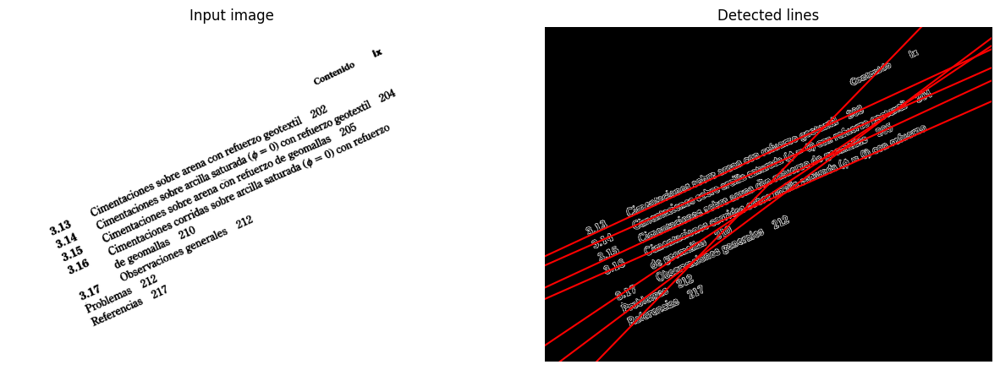

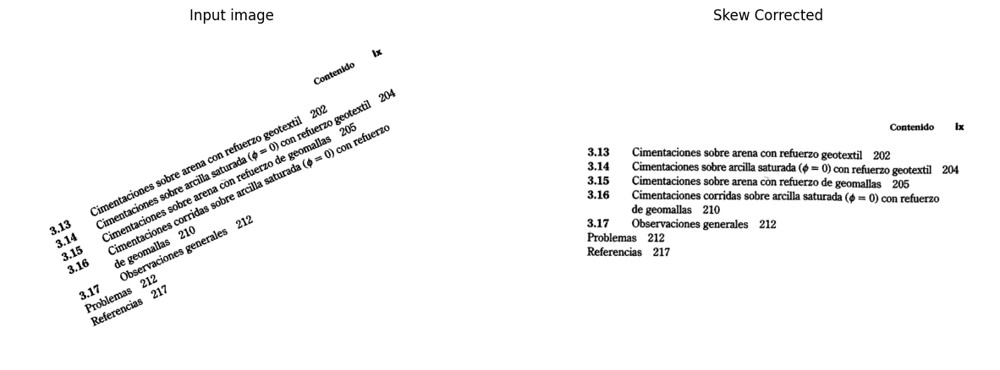

In [33]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/easy/1.png', verbose=True)

Skew Angle is 11.127


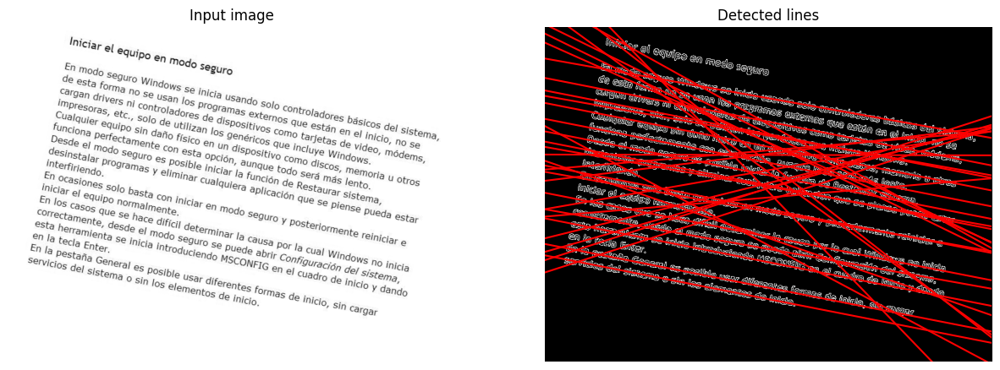

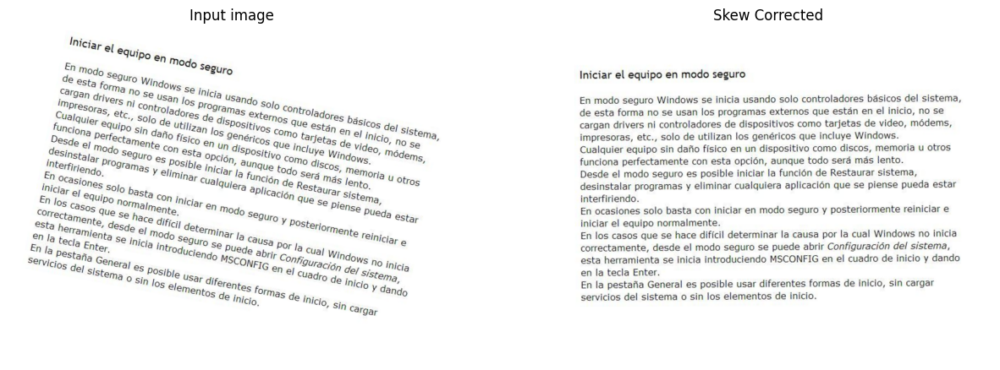

In [34]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/easy/2.png', verbose=True)

Skew Angle is 50.088


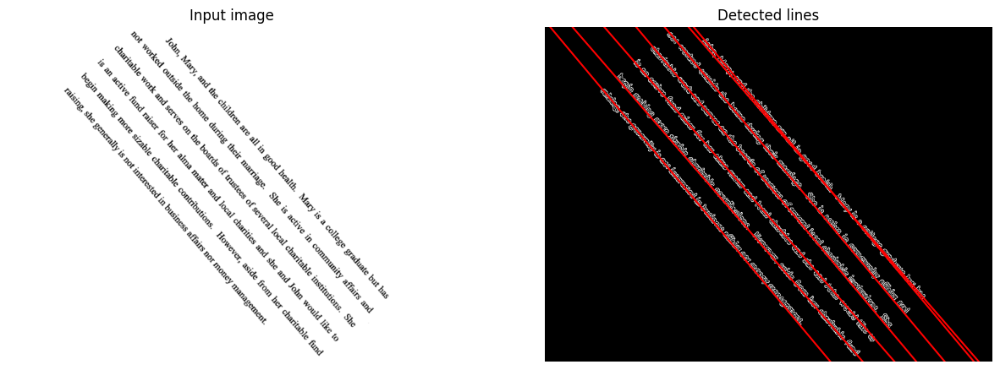

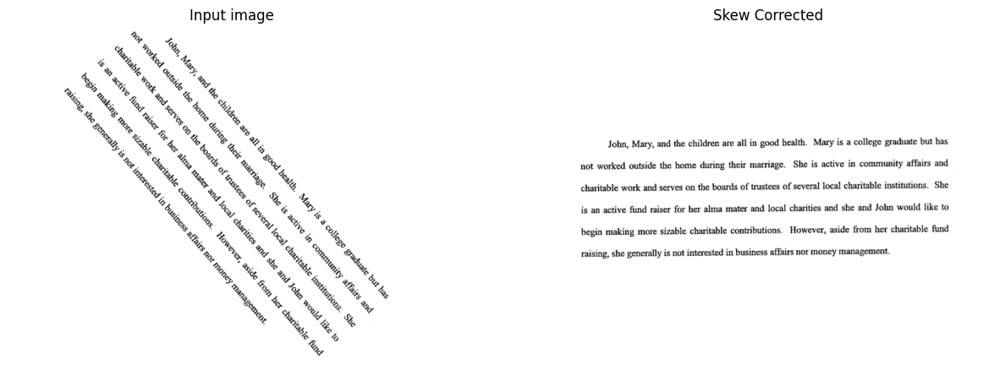

In [35]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/easy/3.png', verbose=True)

Skew Angle is -28.923


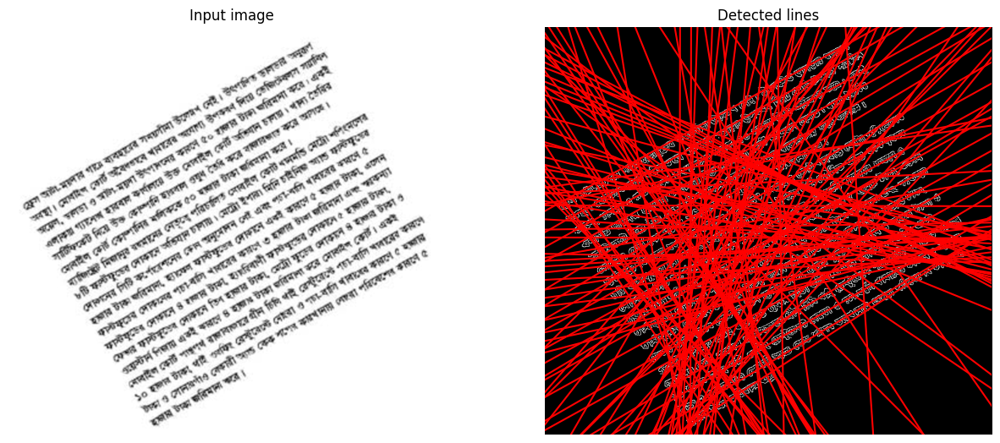

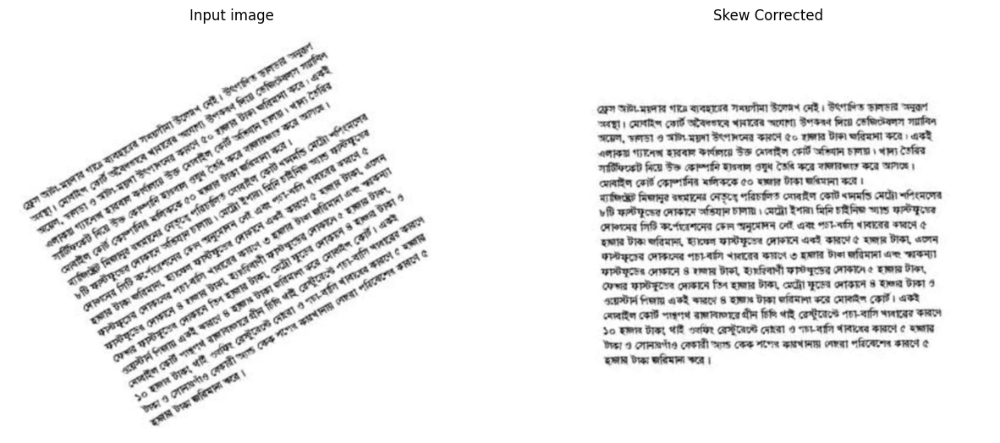

In [36]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/easy/7.png', verbose=True)

Skew Angle is 23.102


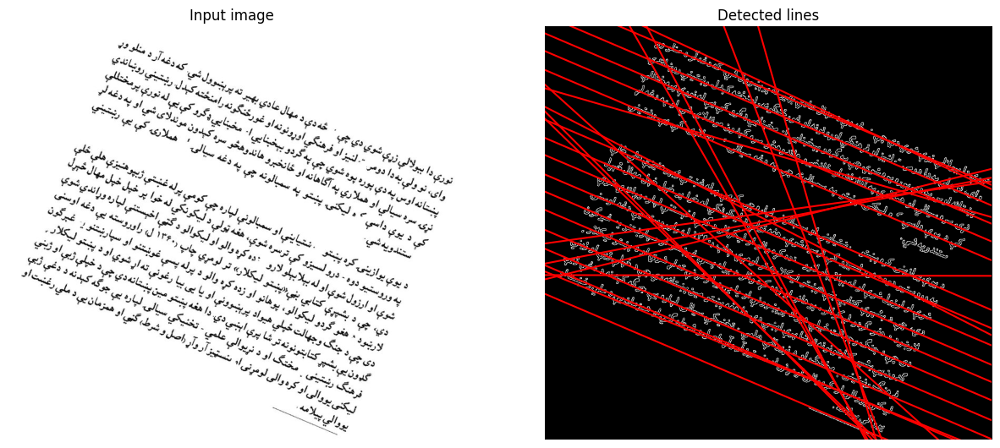

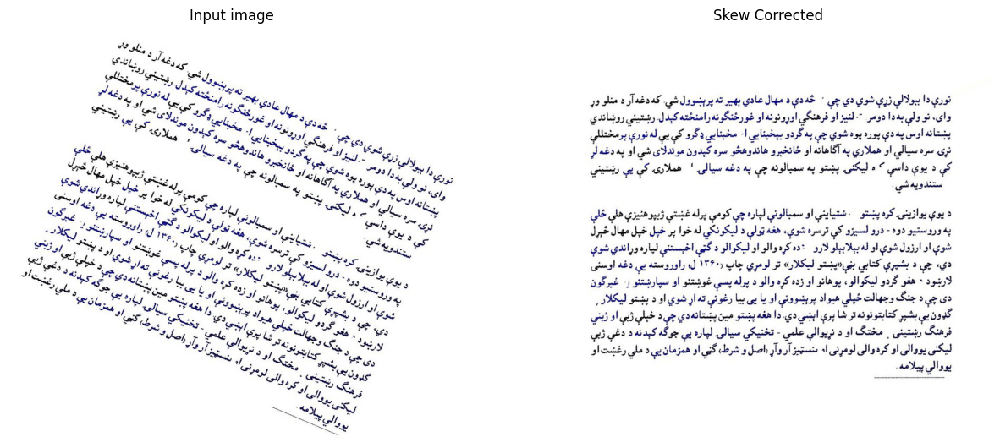

In [37]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/easy/8.png', verbose=True)

Skew Angle is 0.126


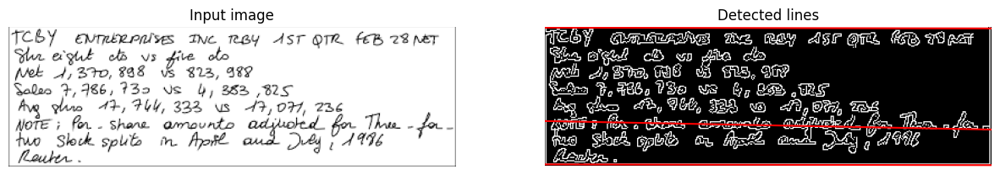

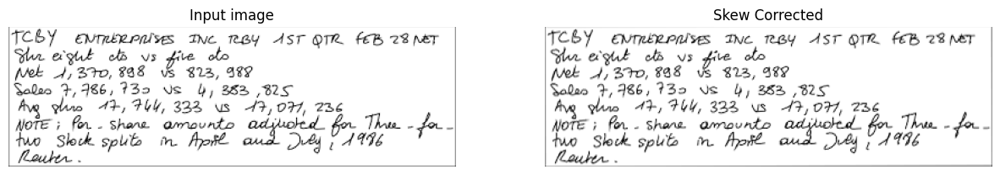

In [38]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/easy/9.png', verbose=True)

Skew Angle is -22.907


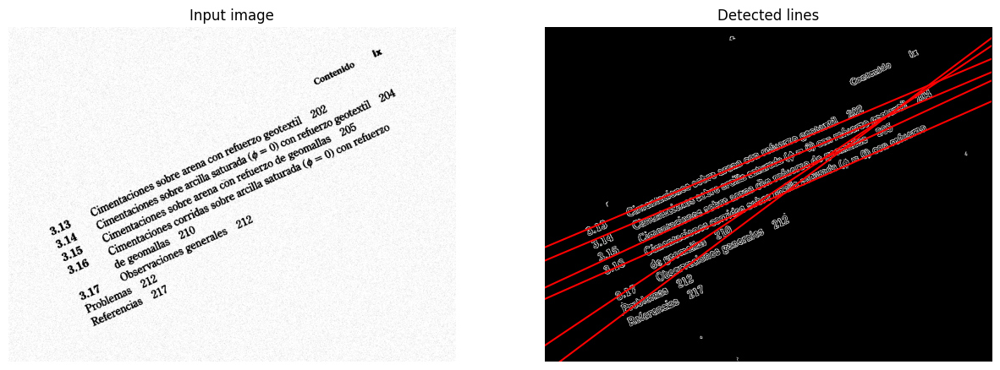

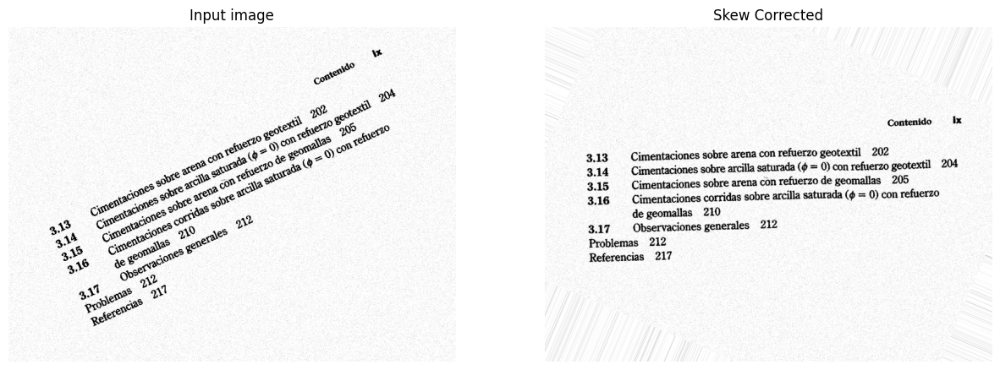

In [39]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/med/1_pn.png', verbose=True)

Skew Angle is -38.892


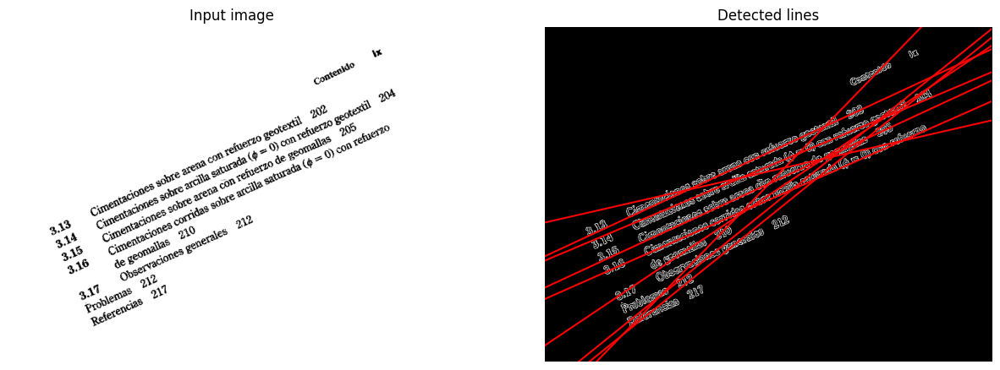

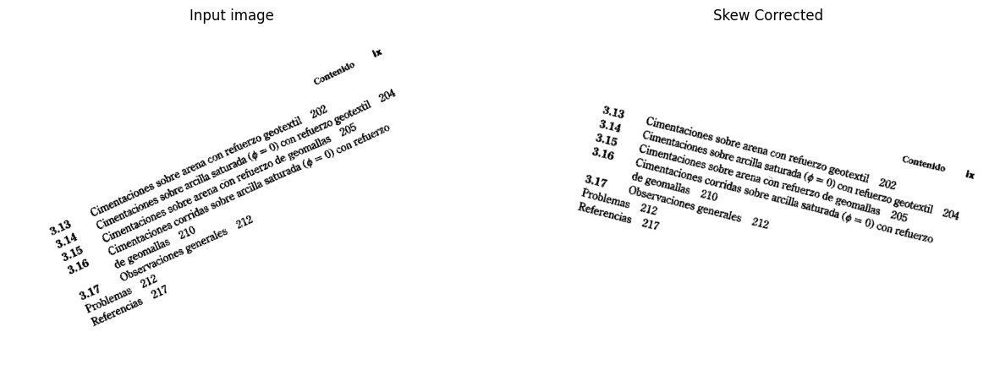

In [43]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/med/1_s.png', verbose=True)

Skew Angle is -80.890


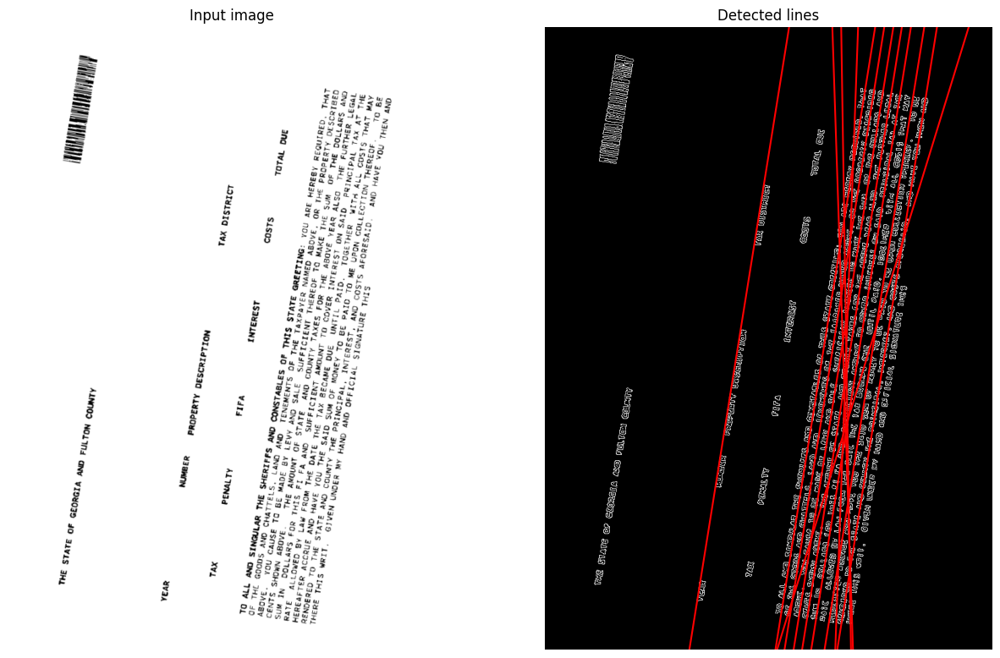

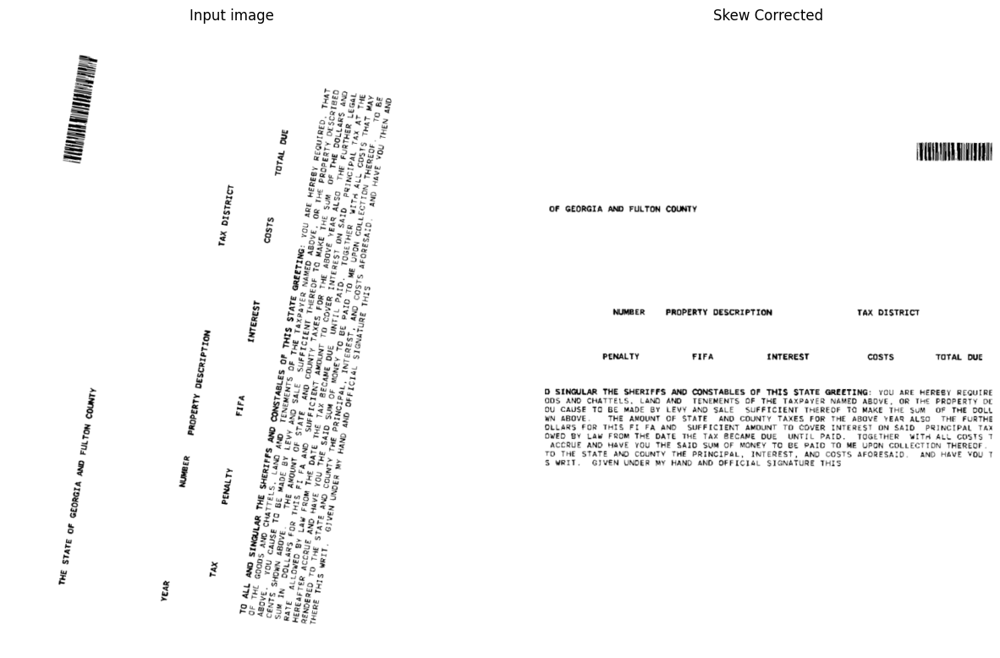

In [60]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/med/4.png',verbose=True)           # shrink before rotating

Skew Angle is -80.890


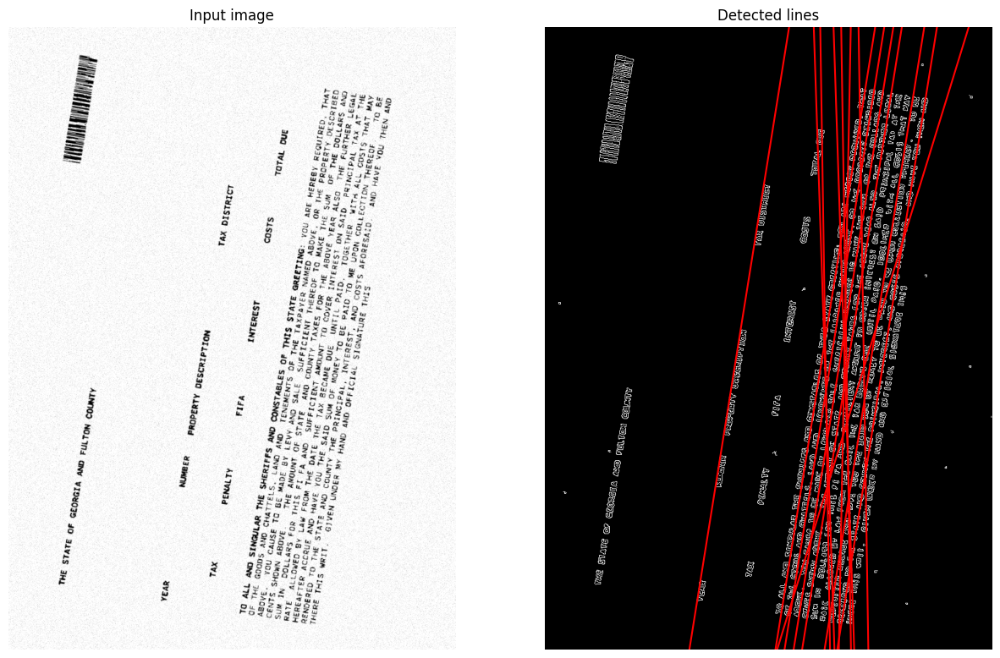

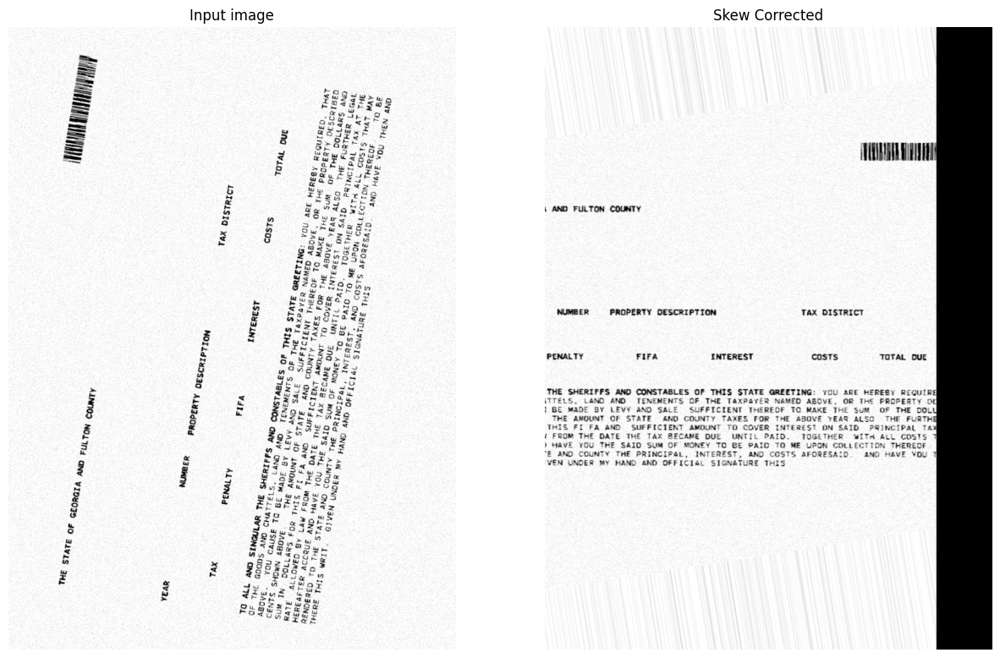

In [63]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/med/4_pn.png', verbose=True)         # need to shrink image before rotating

Skew Angle is -58.888


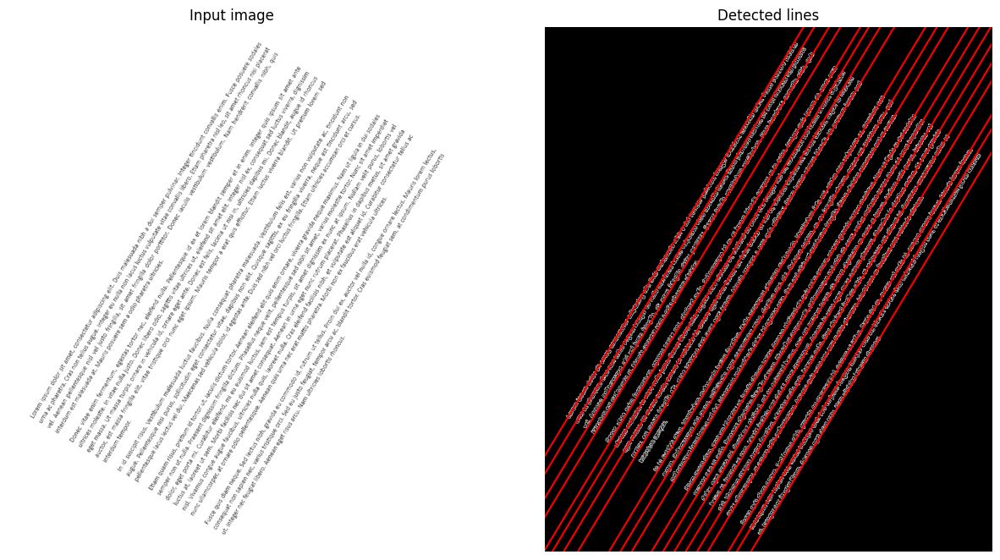

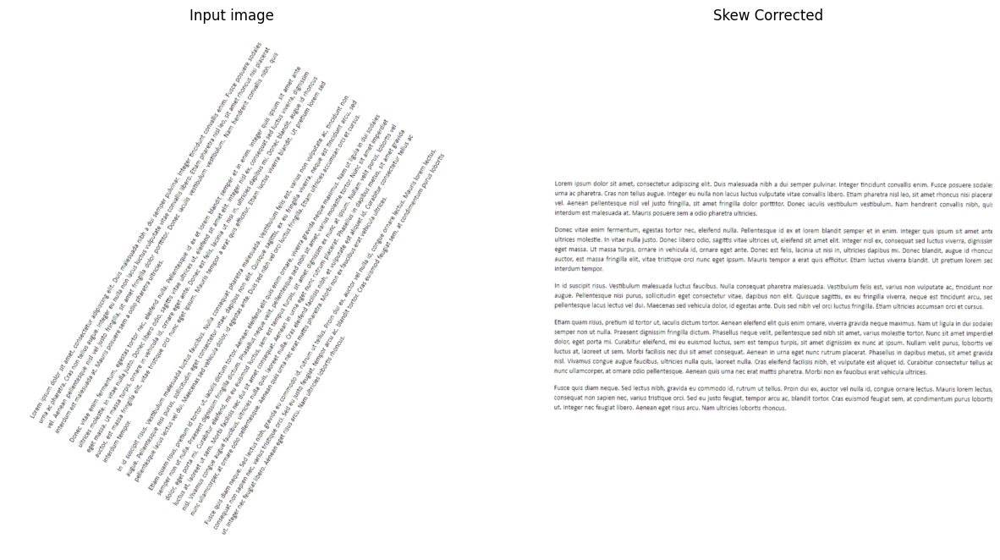

In [47]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/med/6.png', verbose=True)                # shrink before rotating

Skew Angle is -89.885


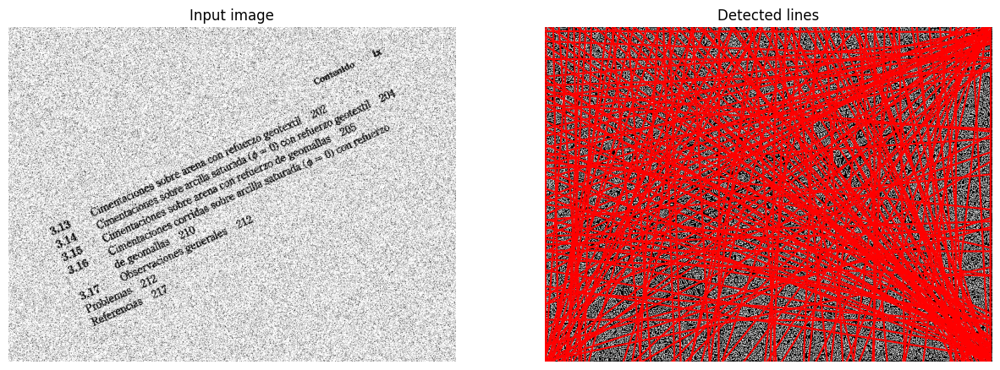

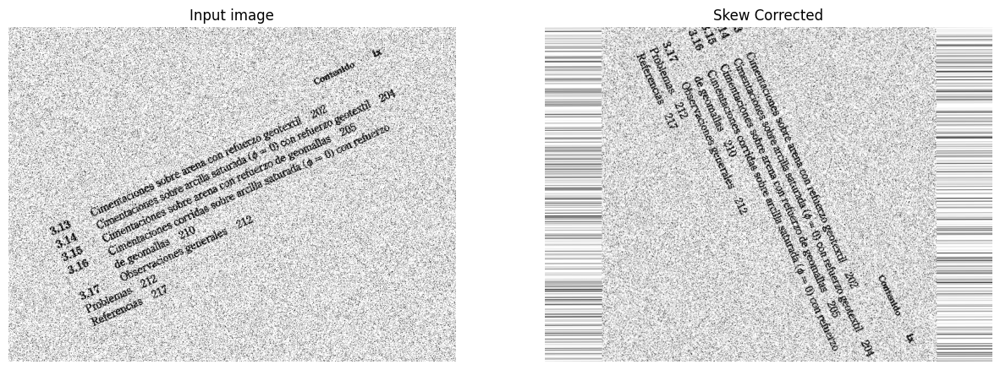

In [66]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/tough/1_gn.png', verbose=True)                 # denoise

Skew Angle is -24.912


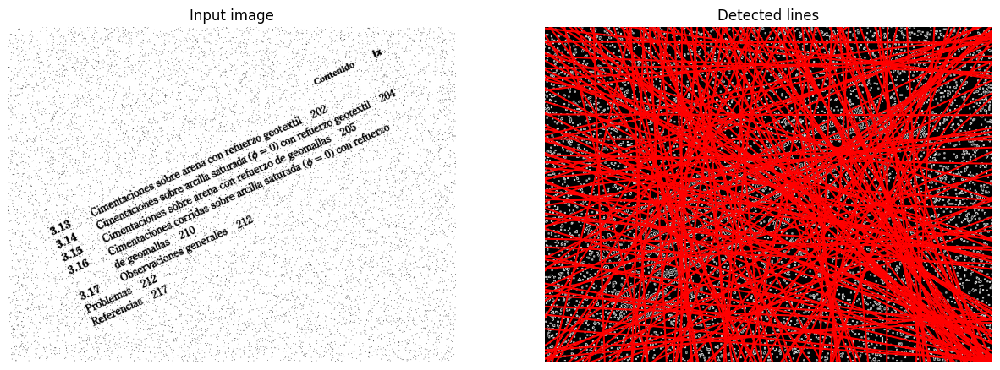

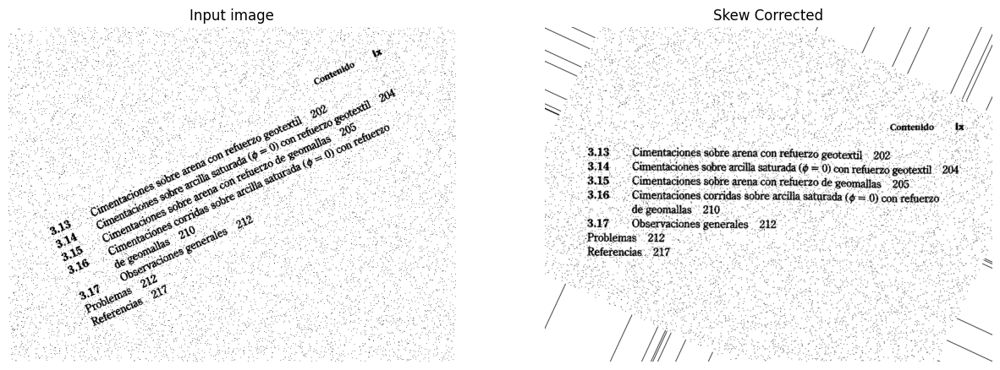

In [67]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/tough/1_sp.png', verbose=True)

Skew Angle is 3.106


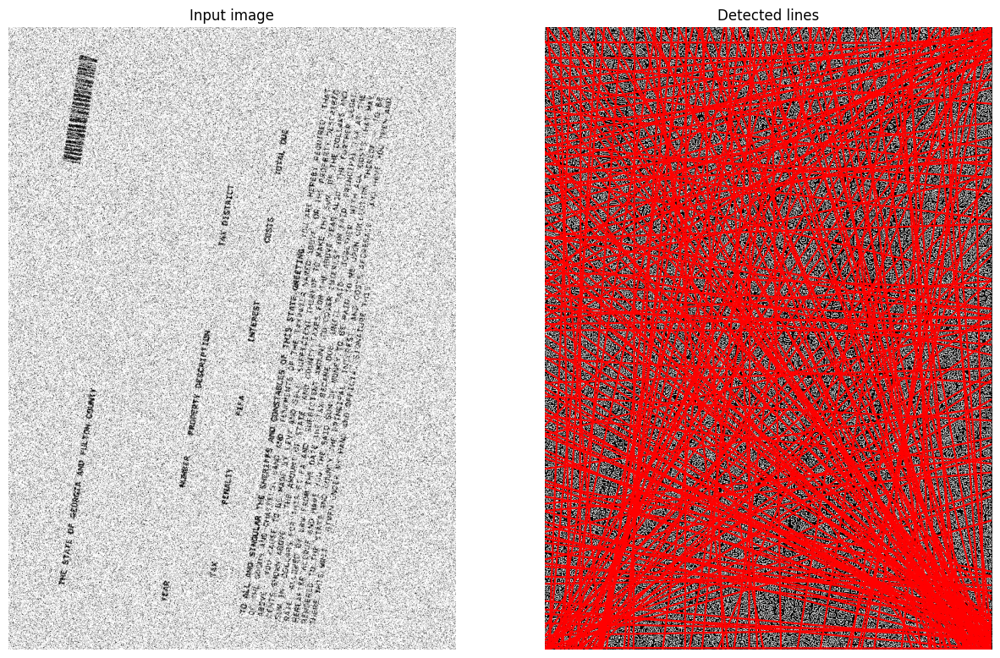

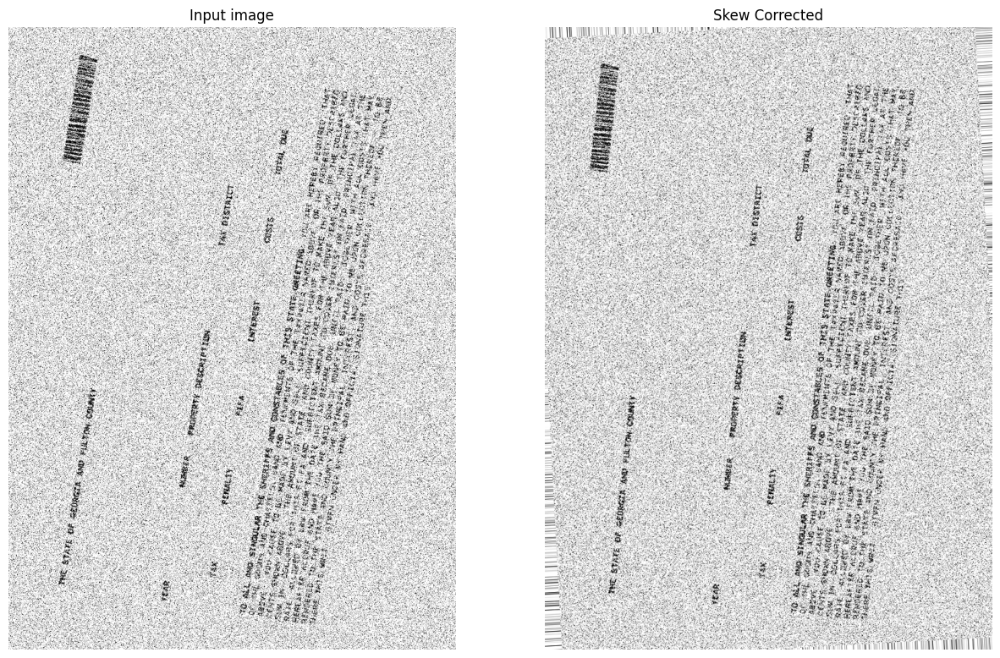

In [68]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/tough/4_gn.png', verbose=True)

Skew Angle is -39.923


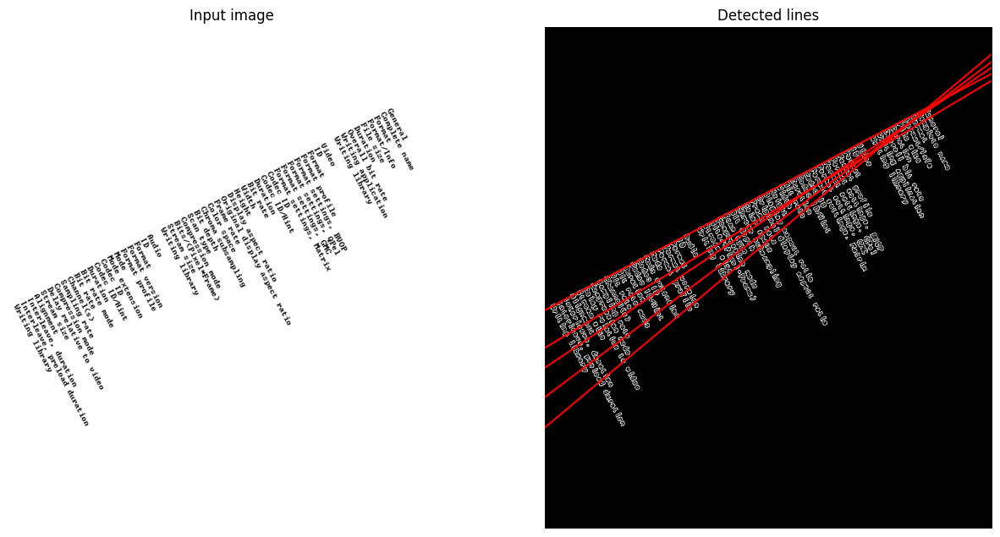

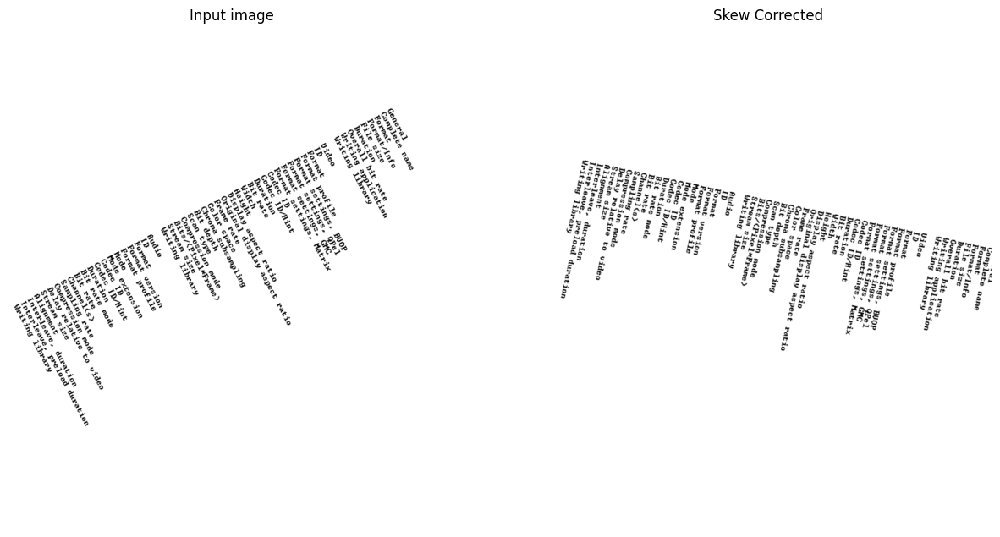

In [69]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/tough/5.png', verbose=True)

Skew Angle is -44.908


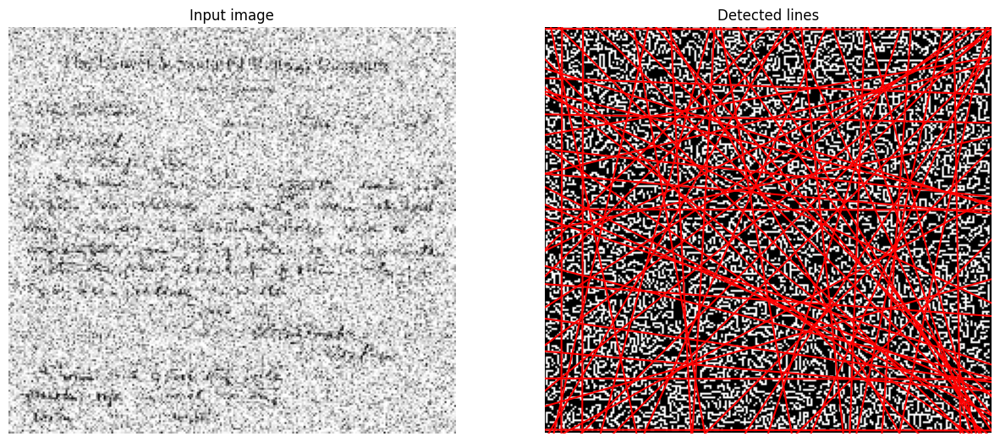

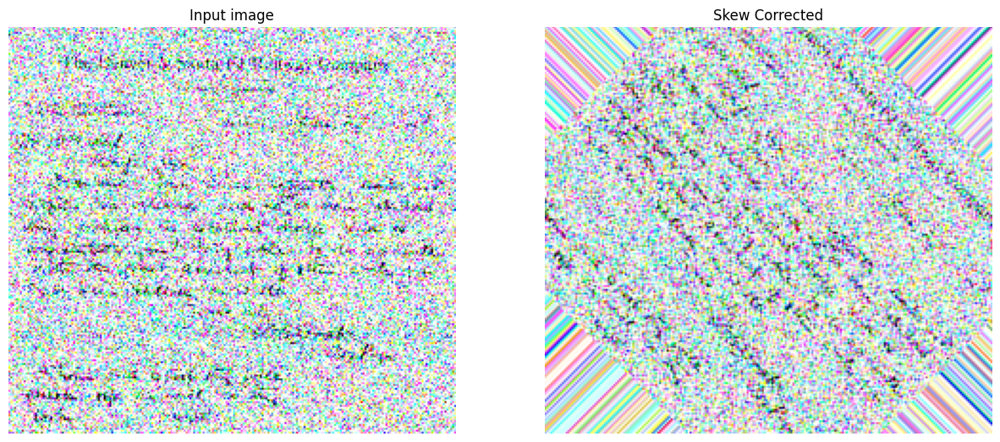

In [71]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/tough/tough_gn.png', verbose=True)

Skew Angle is 0.126


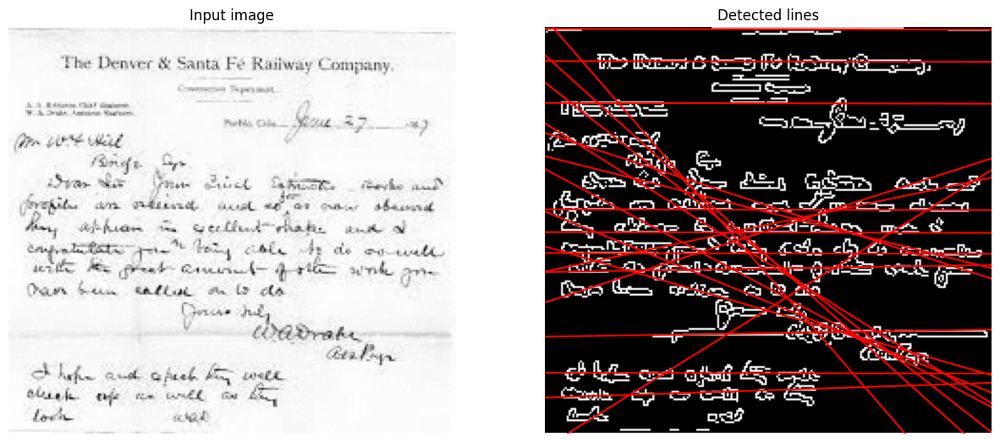

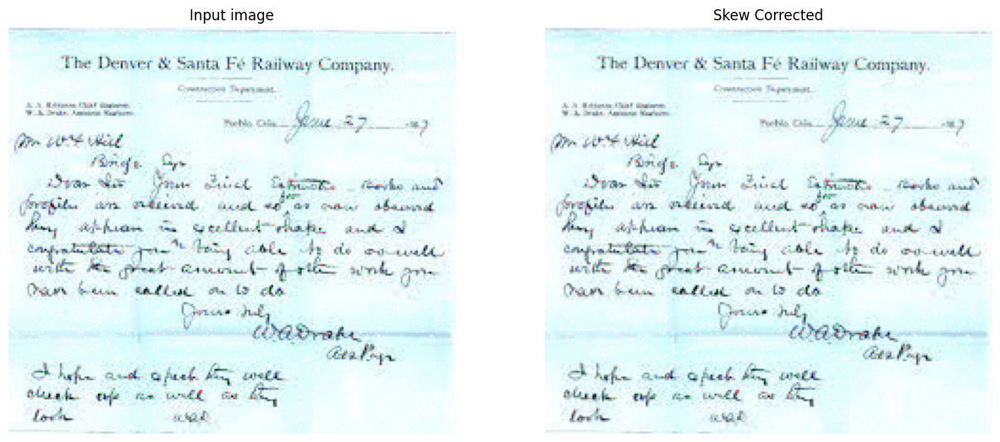

In [74]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/tough/tough_s.png', verbose=True)                # denoising

Skew Angle is 0.126


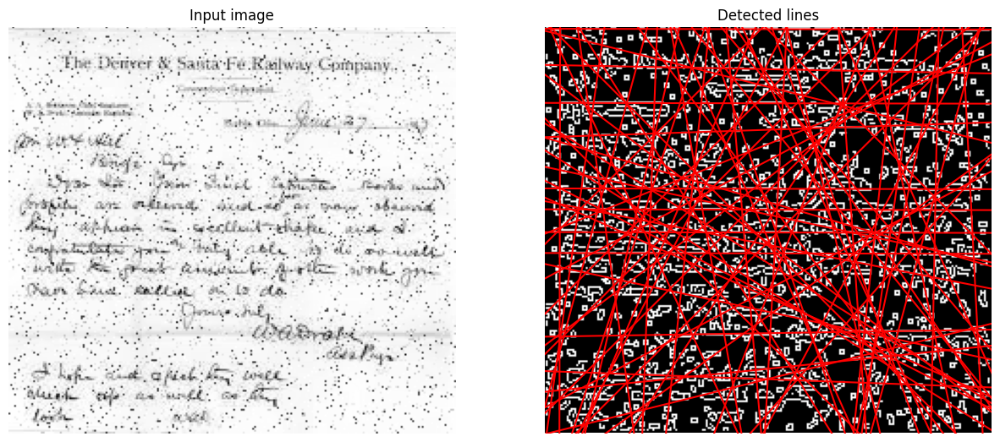

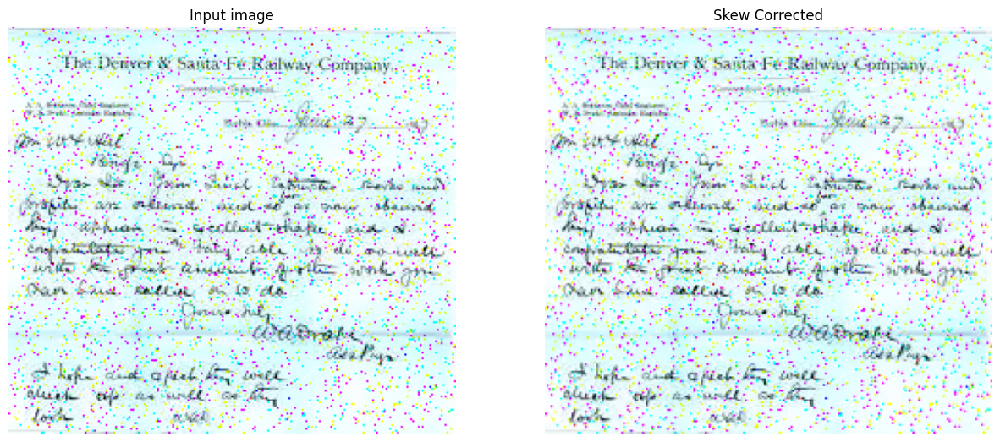

In [75]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/tough/tough_sp.png', verbose=True)

Skew Angle is -44.908


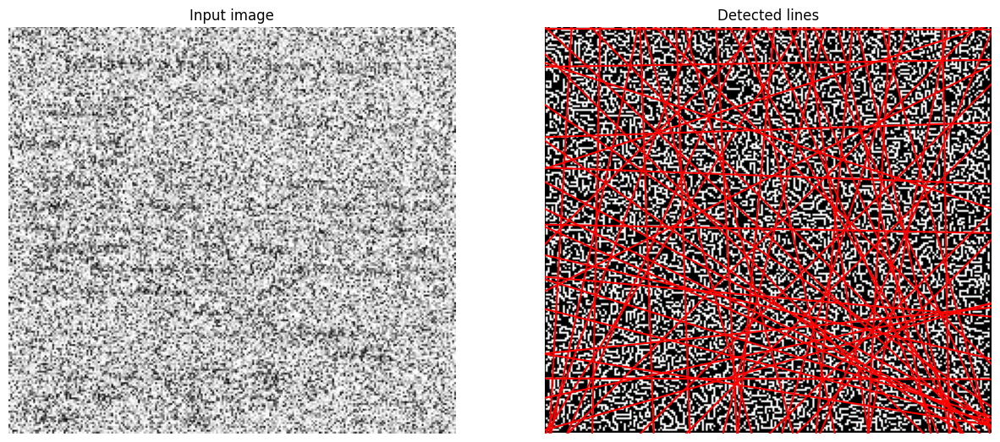

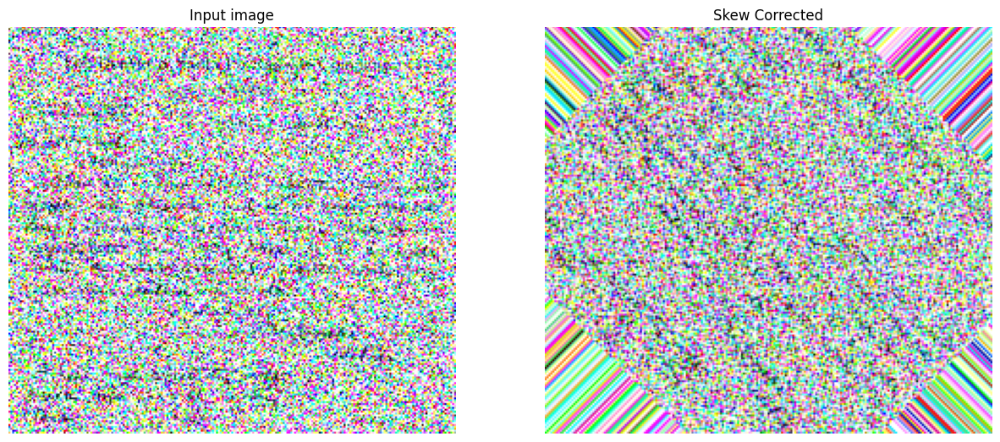

In [77]:
deSkewed_img = SkewCorrection('/content/drive/MyDrive/skew/tough/tough_spkl.png', verbose=True)

There is no One-size-fits-all solution!!
- Possible solutions: Compute the minimum rotated bounding Bounding Rectangle.